In [1]:
#kidney annotation
import os
os.chdir('/lustre/scratch126/cellgen/team297/bs16/current_projects/kidney_glomTI_response/code')
import anndata as ad
import scanpy as sc
import os
import pandas as pd
import numpy as np
import useful_functions as uf
import scvi
import scvelo as scv
sc.set_figure_params(figsize=(6, 6), dpi = 150, fontsize = 10)
import sys
print(sys.executable)
import matplotlib as mpl
import matplotlib.pyplot as plt
import celltypist as ctp

from datetime import datetime
print(datetime.now(tz=None))

Global seed set to 0
/home/jovyan/my-conda-envs/myenv/lib/python3.9/site-packages/pytorch_lightning/utilities/warnings.py:53: LightningDeprecationWarning: pytorch_lightning.utilities.warnings.rank_zero_deprecation has been deprecated in v1.6 and will be removed in v1.8. Use the equivalent function from the pytorch_lightning.utilities.rank_zero module instead.
  new_rank_zero_deprecation(
/home/jovyan/my-conda-envs/myenv/lib/python3.9/site-packages/pytorch_lightning/utilities/warnings.py:58: LightningDeprecationWarning: The `pytorch_lightning.loggers.base.rank_zero_experiment` is deprecated in v1.7 and will be removed in v1.9. Please use `pytorch_lightning.loggers.logger.rank_zero_experiment` instead.
  return new_rank_zero_deprecation(*args, **kwargs)


/home/jovyan/my-conda-envs/myenv/bin/python
2023-07-13 14:52:08.942114


In [2]:
import warnings
warnings.filterwarnings('ignore')
#this will hide the awful pandas deprec warnings that are currently plaguing scanpy

#now print versions
print(sc.__version__)
print(ad.__version__)
print(pd.__version__)
print(scvi.__version__)
print(scv.__version__)
os.chdir('/lustre/scratch126/cellgen/team297/bs16/current_projects/kidney_glomTI_response')

1.9.1
0.8.0
1.5.1
0.19.0
0.2.5


In [3]:
os.chdir('/lustre/scratch126/cellgen/team297/bs16/current_projects/kidney_glomTI_response/data')
adata = sc.read_h5ad("./trained/10X_3p/scanvae_atlas_model/adata.h5ad")

In [4]:
sc.pp.neighbors(adata, use_rep = 'X_scANVI')

In [5]:
sc.tl.umap(adata, min_dist = 0.4)

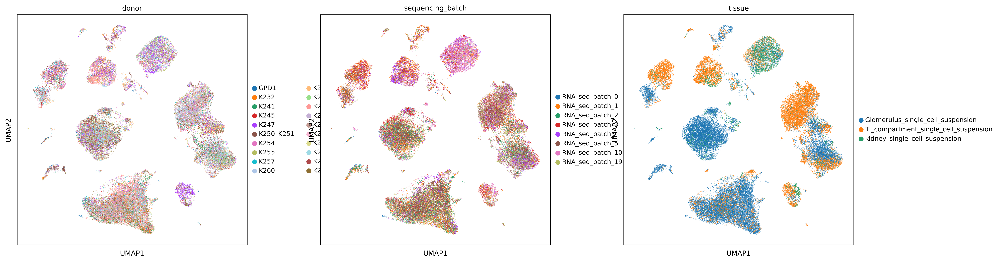

In [6]:
sc.pl.umap(adata, color = ['donor', 'sequencing_batch', 'tissue'], wspace = 0.2)

In [7]:
sc.tl.leiden(adata, resolution = 1)

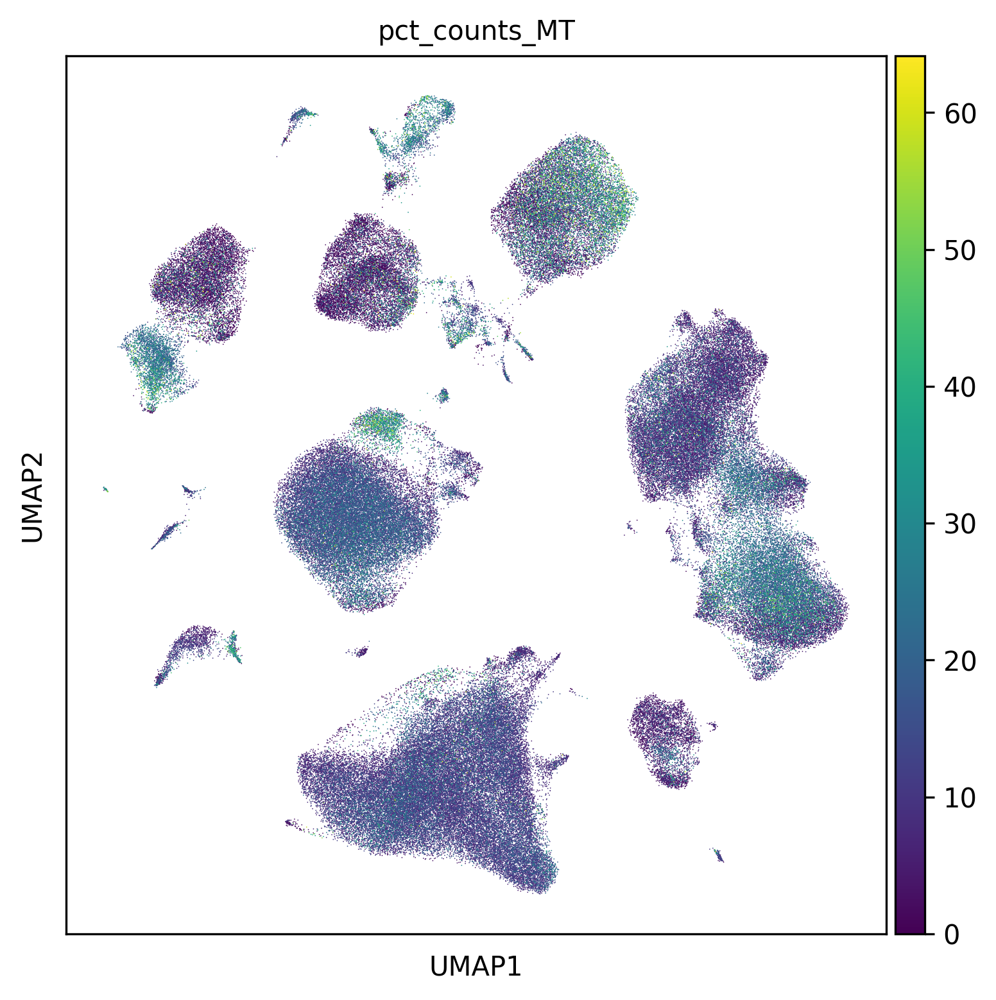

In [8]:
sc.pl.umap(adata, color = 'pct_counts_MT')

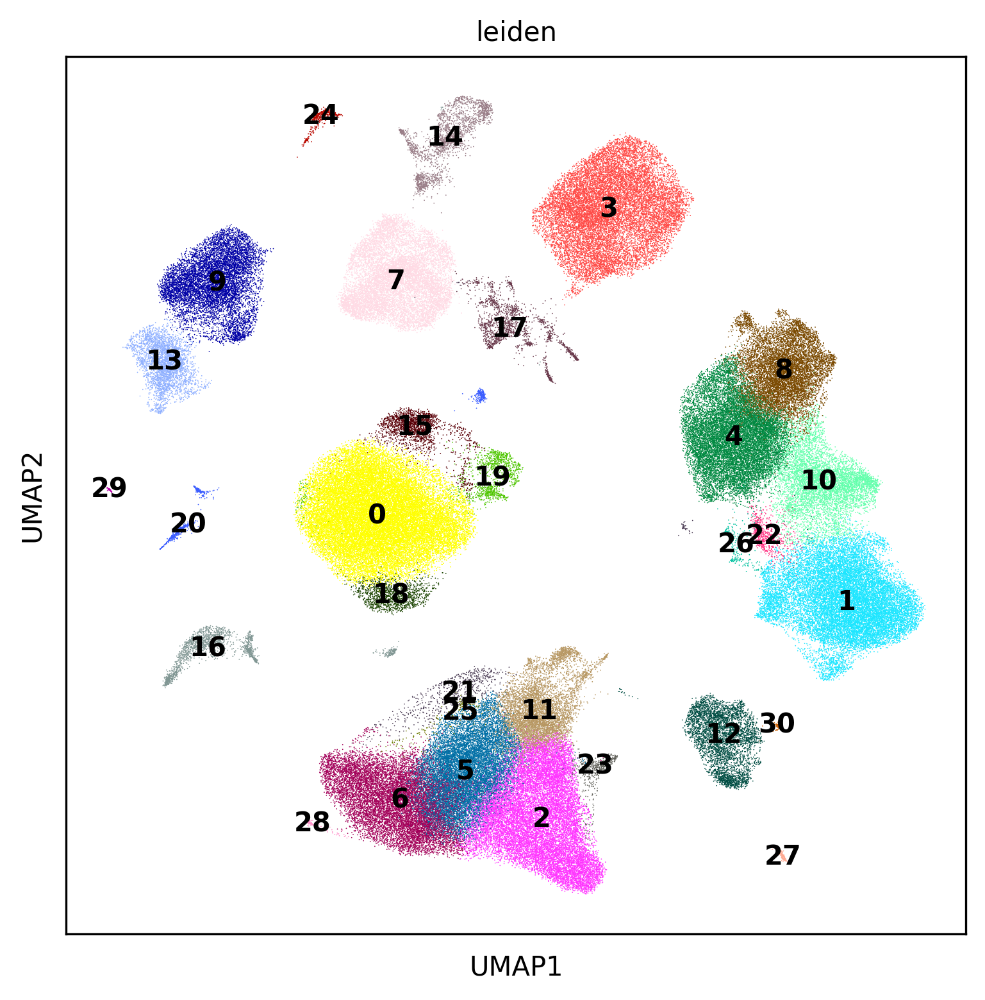

In [9]:
sc.pl.umap(adata, color = ['leiden'], legend_loc = 'on data')

In [10]:
adata.obs['celltype_clusters'] = adata.obs['leiden']
#these need clustering at a lower resolution
for comp in ['11', '12', '20', '1', '8', '17', '14', '16',  '19', '21', '7']:
    print(comp)
    sc.tl.leiden(adata, restrict_to = ('celltype_clusters', [comp]), resolution = 0.1)
    adata.obs['celltype_clusters'] = adata.obs['leiden_R']

11
12
20
1
8
17
14
16
19
21
7


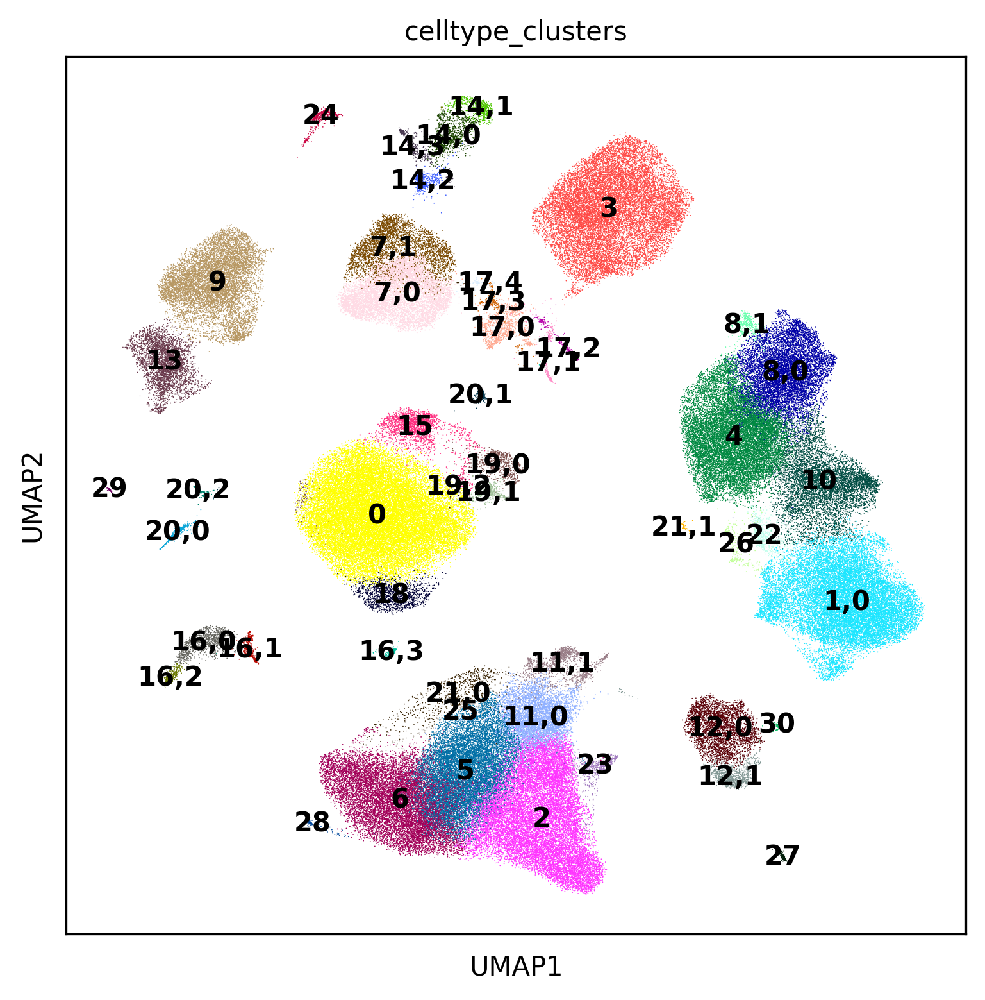

In [11]:
sc.pl.umap(adata, color = ['celltype_clusters'], legend_loc = 'on data')

In [12]:
for comp in ['11,1', '3', '1,0', '6']:
    print(comp)
    sc.tl.leiden(adata, restrict_to = ('celltype_clusters', [comp]), resolution = 0.2)
    adata.obs['celltype_clusters'] = adata.obs['leiden_R']

11,1
3
1,0
6


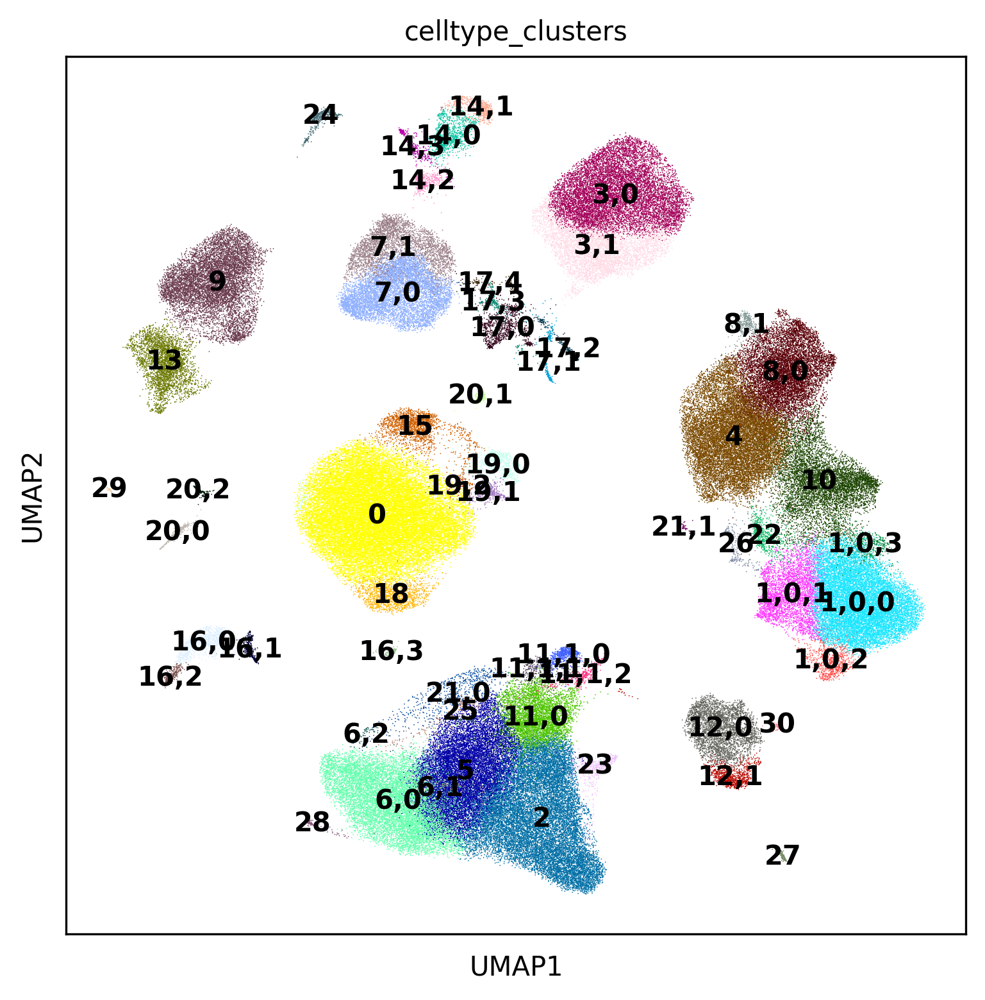

In [13]:
sc.pl.umap(adata, color = ['celltype_clusters'], legend_loc = 'on data')

In [14]:
#markers are more interpretable when using spliced
#import geosketch as gs
#idx = gs.gs(adata.obsm['X_scANVI'], 20000)
#adata.obs['gs_idx'] = adata.obs_names.isin(adata.obs_names.values[idx])
#markers = uf.get_markers(adata[adata.obs['gs_idx']], 'celltype_clusters', 'raw_counts')

In [15]:
#markers['1,0,3'].head(10)

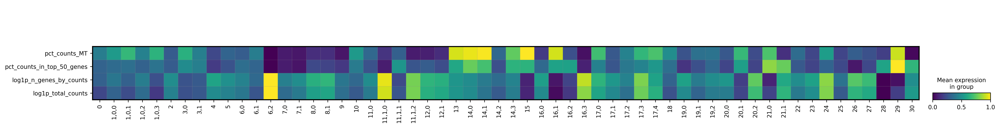

In [16]:
#filter low QC celltype_clusters
#we allow epith
sc.pl.matrixplot(adata, var_names = ['pct_counts_MT', 'pct_counts_in_top_50_genes', 
                                     'log1p_n_genes_by_counts', 'log1p_total_counts',], 
           groupby = 'celltype_clusters', standard_scale = 'var', swap_axes = True, dendrogram = False)

In [17]:
#celltypist annotate immune cells
immune_leiden = ['28', '6', '5', '2', '11', '12', '30', '1', '10', '4', '8', '22', '26', '27']
celltypist_adata = adata.copy()
celltypist_adata = celltypist_adata[celltypist_adata.obs['leiden'].isin(immune_leiden)]
#celltypist annotate immune cells
def get_counts_raw(adata):
    adata_counts = adata.uns['raw_adata'].copy()
    adata_counts = adata_counts[adata.obs_names]
    adata = adata.raw.to_adata()
    adata.layers = adata_counts.layers.copy()
    return(adata)

celltypist_adata = get_counts_raw(celltypist_adata).copy()
celltypist_adata.X = celltypist_adata.layers['raw_counts']
sc.pp.normalize_total(celltypist_adata, target_sum = 10000)
sc.pp.log1p(celltypist_adata)
import celltypist
#do immune predictions
immune_predictions = celltypist.annotate(celltypist_adata, model = 'Immune_All_Low.pkl', 
                                 majority_voting = True)

In [18]:
celltypist_adata.obs['celltypist_immune_prediction'] = immune_predictions.predicted_labels['majority_voting']

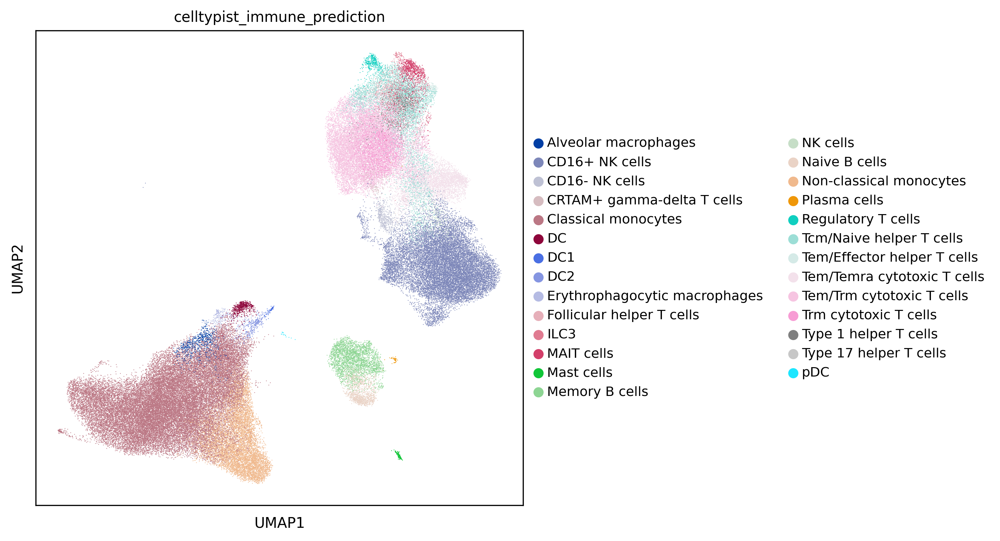

In [19]:
sc.pl.umap(celltypist_adata, color = 'celltypist_immune_prediction')

In [20]:
#this allows us to be more granular with some annotations - adopt the annotations from celltypist
DC2_cells = np.array(celltypist_adata.obs_names[celltypist_adata.obs['celltypist_immune_prediction'].isin(['DC2'])])
DC1_cells = np.array(celltypist_adata.obs_names[celltypist_adata.obs['celltypist_immune_prediction'].isin(['DC1'])])
pDC_cells =  np.array(celltypist_adata.obs_names[celltypist_adata.obs['celltypist_immune_prediction'].isin(['pDC'])])
ILC = np.array(celltypist_adata.obs_names[celltypist_adata.obs['celltypist_immune_prediction'].isin(['ILC3'])])
MAIT =  np.array(celltypist_adata.obs_names[celltypist_adata.obs['celltypist_immune_prediction'].isin(['MAIT cells'])])

In [21]:
#annotate cells
celltype_map = {
'0' : 'GEC',
'1,0,0' : 'NK1',
'1,0,1' : 'NK1',
'1,0,2' : 'activated_NK1',
'1,0,3' : 'NK1', 
'2' : 'nonclassical_monocyte',
'3,0' : 'convoluted_PTEC',
'3,1' :'straight_PTEC', #SLC5A8 #SLC5A10 #SLC5A1,
'4' : 'CD8_T_cell',
'5' : 'lipid_handling_monocyte', 
'6,0' : 'classical_monocyte',
'6,1' : 'classical_monocyte',
'6,2' : 'proliferating_monocyte',
'7,0' : 'medullary_TAL_LOH',
'7,1' : 'cortical_TAL_LOH',
'8,0' : 'CD4_T_cell',
'8,1' : 'Treg',
'9' : 'CCD',
'10' : 'NKT_cell',
'11,0' : 'nonclassical_monocyte_complement',
'11,1,0' : 'TREM2_macrophage',
'11,1,1' : 'tissue_macrophage',
'11,1,2' : 'cDC2',
'12,0' : 'memory_B_cell',
'12,1' : 'naive_B_cell',
'13' : 'IC_A', #IC
'14,0' : 'PC',
'14,1' : 'PC',
'14,2' : 'DCT',
'14,3' : 'DCT',
'15' : 'low_quality', #high MT for endo, conspicuously low quality
'16,0' :'podocyte',
'16,1': 'low_quality', #high MT for podocyte
'16,2': 'podocyte',
'16,3' : 'podocyte',
'17,0' : 'CNT',
'17,1' : 'GPEC',
'17,2' : 'injured_PTEC',
'17,3' : 'DTL_LOH',
'17,4' : 'DTL_LOH',
'18' : 'GEC',
'19,0' : 'AE',
'19,1' : 'PCE',
'19,2' : 'GEC',
'20,0' : 'MC',
'20,1' : 'VSMC',
'20,2' : 'medullary_myofibroblast',
'21,0' : 'low_quality', #high MT
'21,1' : 'low_quality', #hb contaminated
'22' : 'NK2',
'23' : 'low_quality', #doublet
'24' : 'IC_B',
'25' : 'low_quality', #doublet
'26' : 'proliferating_NK',
'27' : 'mast_cell',
'28' : 'neutrophil', 
'29' : 'megakaryocyte',
'30' : 'plasma_cell'
}
adata.obs['cell_type'] = adata.obs['celltype_clusters'].map(celltype_map).astype('category')

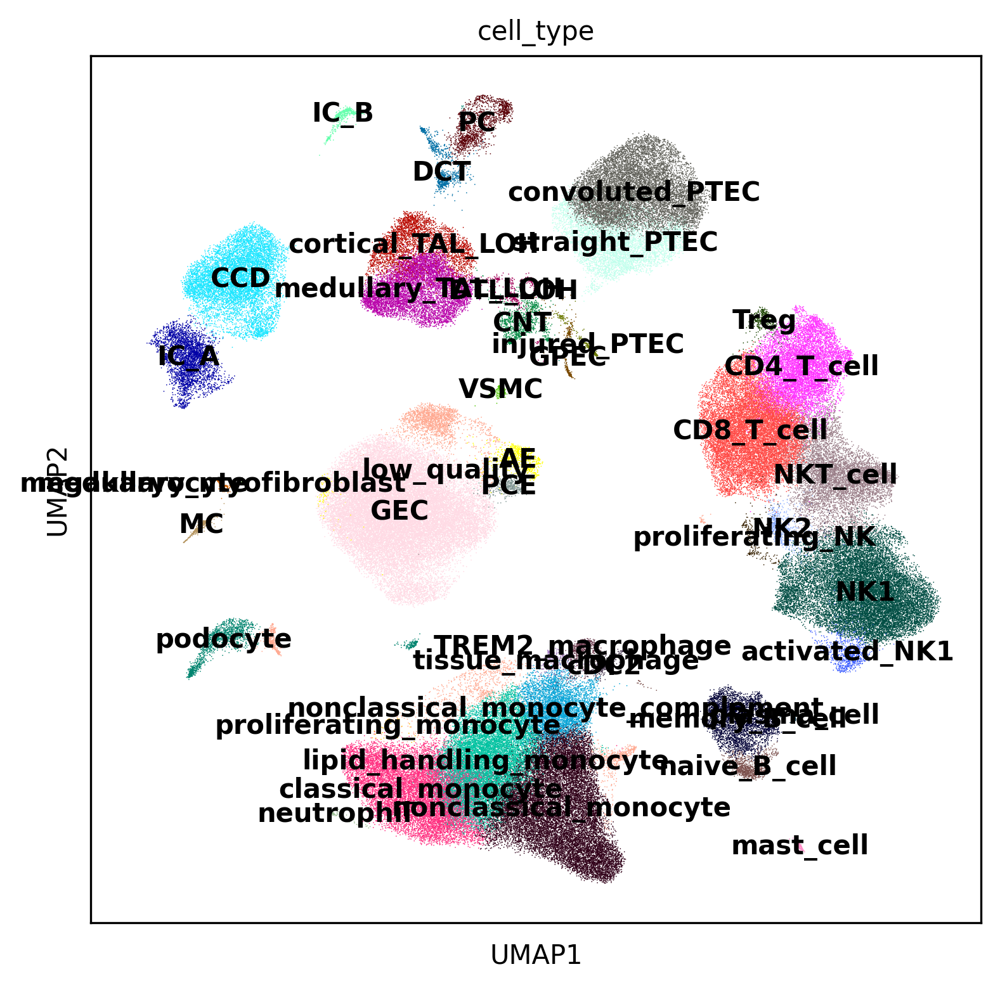

In [22]:
sc.pl.umap(adata, color = ['cell_type'], legend_loc = 'on data')

In [23]:
ct = np.array(adata.obs['cell_type'])
ct[adata.obs_names.isin(DC1_cells)] = 'cDC1'
ct[adata.obs_names.isin(DC2_cells)] = 'cDC2'
ct[adata.obs_names.isin(pDC_cells)] = 'pDC'
ct[adata.obs_names.isin(MAIT)] = 'MAIT'
ct[adata.obs_names.isin(ILC)] = 'ILC'
adata.obs['cell_type'] = ct

In [24]:
#remove low quality clusters
adata = adata[~adata.obs['cell_type'].isin(['low_quality'])]

In [25]:
#make the cell types categorical
ct_categories = ['podocyte',
'convoluted_PTEC',
'straight_PTEC', 
'injured_PTEC',
'GPEC', 
'DTL_LOH',
'medullary_TAL_LOH',
'cortical_TAL_LOH',
'DCT', 
'CNT', 
'PC', 
'IC_A', 
'IC_B',
'CCD', 
'AE',
'GEC', 
'PCE',                  
'MC', 
'VSMC',
'medullary_myofibroblast', 
'naive_B_cell', 
'memory_B_cell',
'plasma_cell',            
'CD4_T_cell', 
'Treg',  
'CD8_T_cell',
'proliferating_T_cell',
'NK1', 
'activated_NK1',
'NK2',
'proliferating_NK',
'MAIT',
'ILC',
'NKT_cell',
'cDC1', 
'cDC2', 
'classical_monocyte', 
'nonclassical_monocyte',
'nonclassical_monocyte_complement',
'lipid_handling_monocyte',
'proliferating_monocyte',
'tissue_macrophage',
'TREM2_macrophage',
'neutrophil',
'pDC',
'mast_cell',
'megakaryocyte'
]
adata.obs['cell_type'] = pd.Categorical(adata.obs['cell_type'], categories=ct_categories)

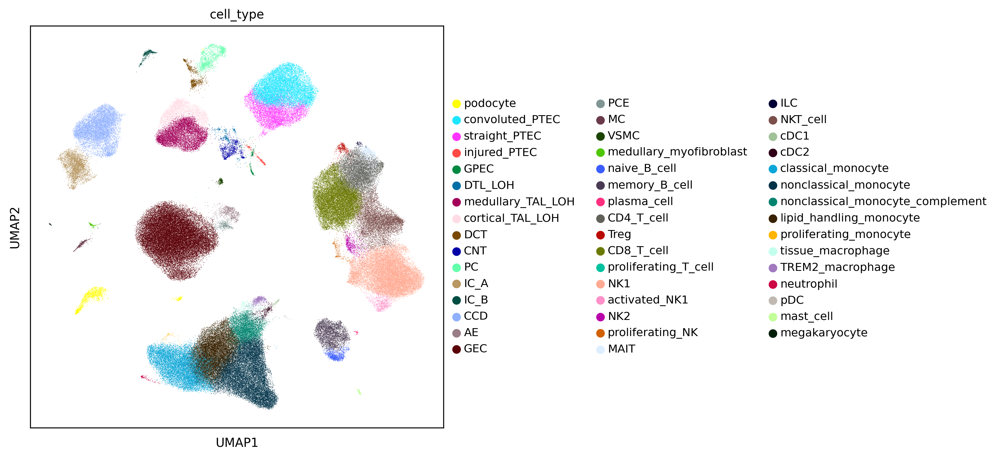

In [26]:
sc.pl.umap(adata, color = 'cell_type')

In [27]:
#do compartments
compartment_map = {'podocyte' : 'nephron', 
'convoluted_PTEC' : 'nephron',
'straight_PTEC': 'nephron', 
'injured_PTEC': 'nephron',
'GPEC': 'nephron', 
'DTL_LOH': 'nephron',
'medullary_TAL_LOH': 'nephron',
'cortical_TAL_LOH': 'nephron',
'DCT': 'nephron', 
'CNT': 'nephron', 
'PC': 'nephron', 
'IC': 'nephron',
'IC_A': 'nephron', 
'IC_B': 'nephron',
'CCD': 'nephron', 
'GEC': 'endothelium', 
'AE': 'endothelium',
'PCE': 'endothelium',                  
'MC': 'stroma', 
'VSMC': 'stroma',
'medullary_myofibroblast': 'stroma', 
'naive_B_cell': 'immune_lymphoid', 
'memory_B_cell': 'immune_lymphoid',
'plasma_cell': 'immune_lymphoid',            
'CD4_T_cell': 'immune_lymphoid', 
'Treg': 'immune_lymphoid',  
'ILC': 'immune_lymphoid', 
'MAIT': 'immune_lymphoid',
'CD8_T_cell': 'immune_lymphoid',
'proliferating_T_cell': 'immune_lymphoid',
'NK1': 'immune_lymphoid', 
'activated_NK1': 'immune_lymphoid',
'NK2': 'immune_lymphoid',
'proliferating_NK': 'immune_lymphoid',
'MAIT' : 'immune_lymphoid',
'NKT_cell': 'immune_lymphoid',
'cDC1': 'immune_myeloid', 
'cDC2': 'immune_myeloid', 
'pDC' : 'immune_myeloid',
'classical_monocyte': 'immune_myeloid', 
'nonclassical_monocyte': 'immune_myeloid',
'nonclassical_monocyte_complement': 'immune_myeloid',
'lipid_handling_monocyte': 'immune_myeloid',
'proliferating_monocyte': 'immune_myeloid',
'tissue_macrophage': 'immune_myeloid',
'TREM2_macrophage': 'immune_myeloid',
'neutrophil': 'immune_myeloid',
'mast_cell': 'immune_myeloid',
'megakaryocyte': 'immune_myeloid'}
# add a new `.obs` column called `cell type` by mapping clusters to annotation using pandas `map` function
adata.obs['compartment'] = adata.obs['cell_type'].map(compartment_map).astype('category')

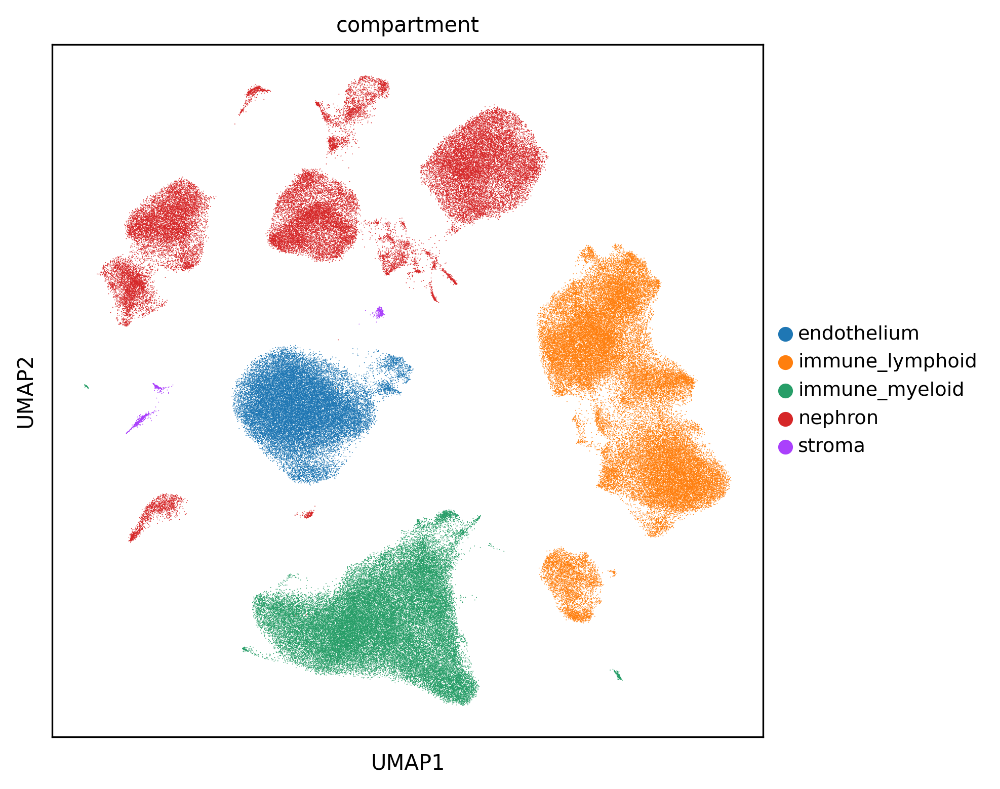

In [28]:
#with the levels ordered.
sc.pl.umap(adata, color = 'compartment')

In [29]:
#now broad celltypes
celltype_label_mapping = {
    'CCD' : 'collecting_duct',
    'CD4_T_cell' : 'CD4_T_cell', 
    'CD8_T_cell' : 'CD8_T_cell',
    'CNT' : 'CNT', 
    'DCT' : 'DCT',
    'DTL_LOH' : 'DTL_LOH',
   'AE' : 'AE',
    'GEC' : 'GEC',
    'GPEC' : 'GPEC',
    'IC_A' : 'IC',
    'IC_B' : 'IC',
    'ILC' : 'ILC', 
    'MAIT' : 'MAIT',
    'MC' : 'MC',
    'NK1' : 'NK1',
    'NK2':  'NK2',
    'NKT_cell' : 'NKT_cell',
    'PC' : 'PC',
    'PCE' : 'PCE',
    'TREM2_macrophage' : 'TREM2_macrophage',
    'Treg' : 'Treg', 
    'VSMC' : 'VSMC',
       'activated_NK1' : 'NK1',
    'cDC1' : 'cDC', 
    'cDC2' : 'cDC', 
    'pDC' : 'pDC',
    'classical_monocyte' : 'classical_monocyte',
    'convoluted_PTEC' : 'PTEC',
    'cortical_TAL_LOH' : 'TAL_LOH', 
    'injured_PTEC' : 'PTEC',
    'lipid_handling_monocyte' : 'classical_monocyte',
    'mast_cell' : 'mast_cell',
    'medullary_TAL_LOH' : 'TAL_LOH',
    'medullary_myofibroblast' : 'Mfib', 
    'megakaryocyte' : 'megakaryocyte', 
    'memory_B_cell' : 'B_cell',
       'naive_B_cell' : 'B_cell', 
    'neutrophil' : 'neutrophil', 
    'nonclassical_monocyte' : 'nonclassical_monocyte',
       'nonclassical_monocyte_complement' : 'nonclassical_monocyte', 
    'plasma_cell' : 'plasma_cell', 
    'podocyte' : 'podocyte',
       'prl_GEC' : 'GEC', 'proliferating_NK' : 'NK1', 'proliferating_T_cell' : 'CD4_T_cell',
       'proliferating_monocyte' : 'classical_monocyte', 'straight_PTEC' : 'PTEC', 'tissue_macrophage' : 'tissue_macrophage'
}
# add a new `.obs` column called `cell type` by mapping clusters to annotation using pandas `map` function
adata.obs['broad_cell_type'] = adata.obs['cell_type'].map(celltype_label_mapping).astype('category')

In [30]:
#make the cell types categorical
bct_categories = [
'podocyte',
'GPEC',
'PTEC',
'TAL_LOH',
'DTL_LOH',
'DCT',
'CNT',
'PC',
'IC',
'collecting_duct',
'AE',
'GEC',
'PCE',
'MC',
'Mfib',
'VSMC',
'classical_monocyte',
'nonclassical_monocyte',
'cDC',
'TREM2_macrophage',
'tissue_macrophage',
'neutrophil',
'pDC',
'mast_cell',
'megakaryocyte',
'B_cell',
'plasma_cell',
'CD4_T_cell',
'Treg',
'CD8_T_cell',
'NK1',
'NK2',
'NKT_cell',
'ILC',
'MAIT',
]
adata.obs['broad_cell_type'] = pd.Categorical(adata.obs['broad_cell_type'], categories=bct_categories)

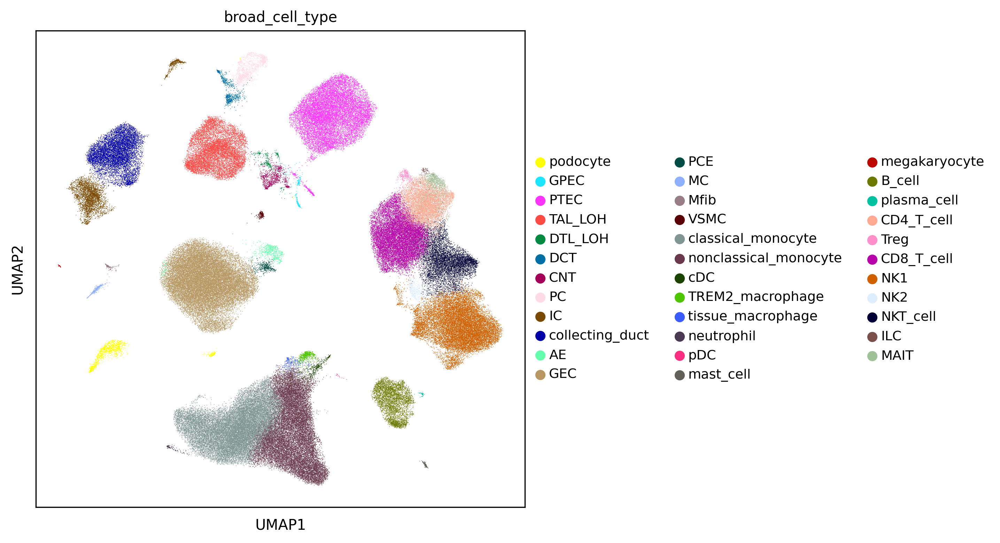

In [31]:
sc.pl.umap(adata, color = 'broad_cell_type')

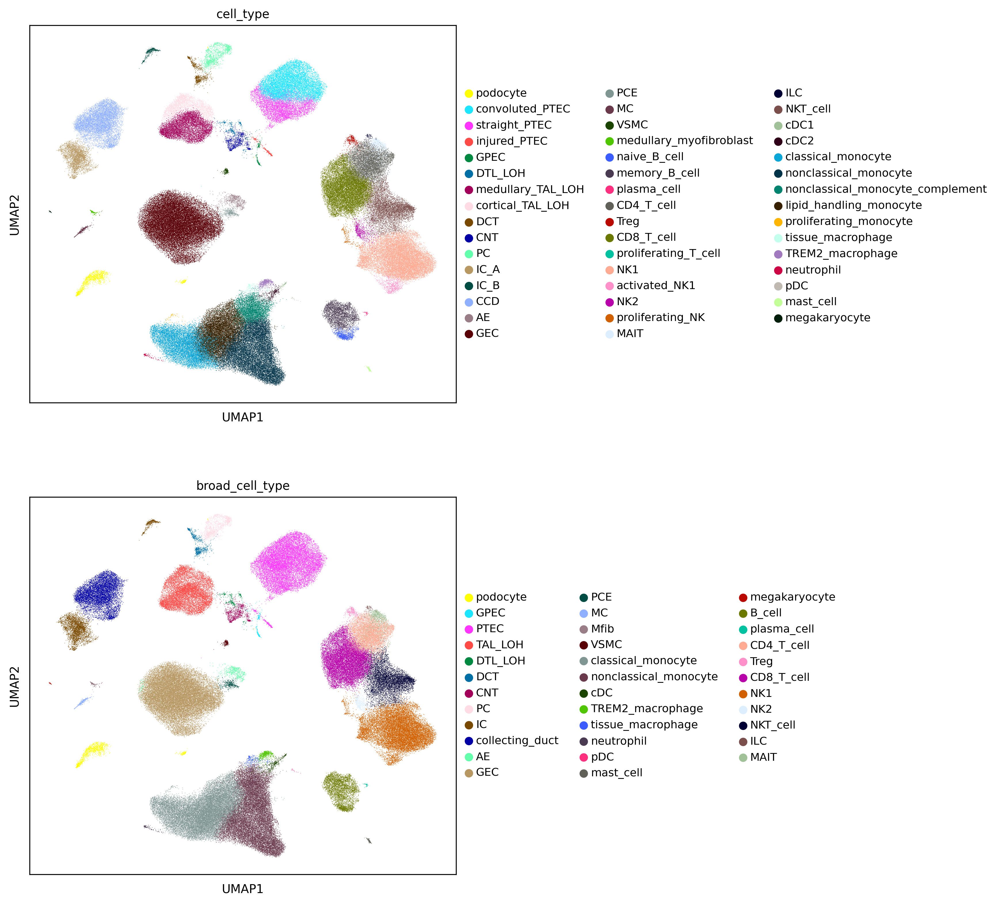

In [32]:
#with the levels ordered 
sc.pl.umap(adata, color = ['cell_type', 'broad_cell_type'], ncols =1)

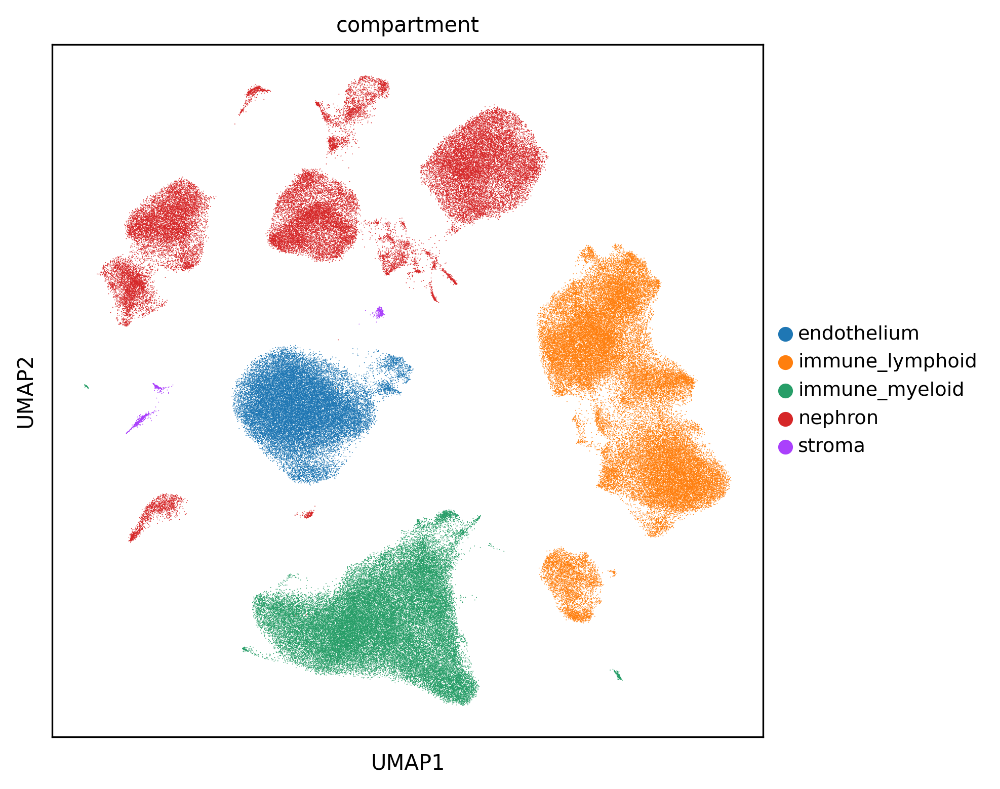

In [33]:
adata.uns['compartment_colors'] = ['darkblue', 'brown', 'darkgreen', 'orange']
#with the levels ordered and PAGA initialisation
sc.pl.umap(adata, color = 'compartment')

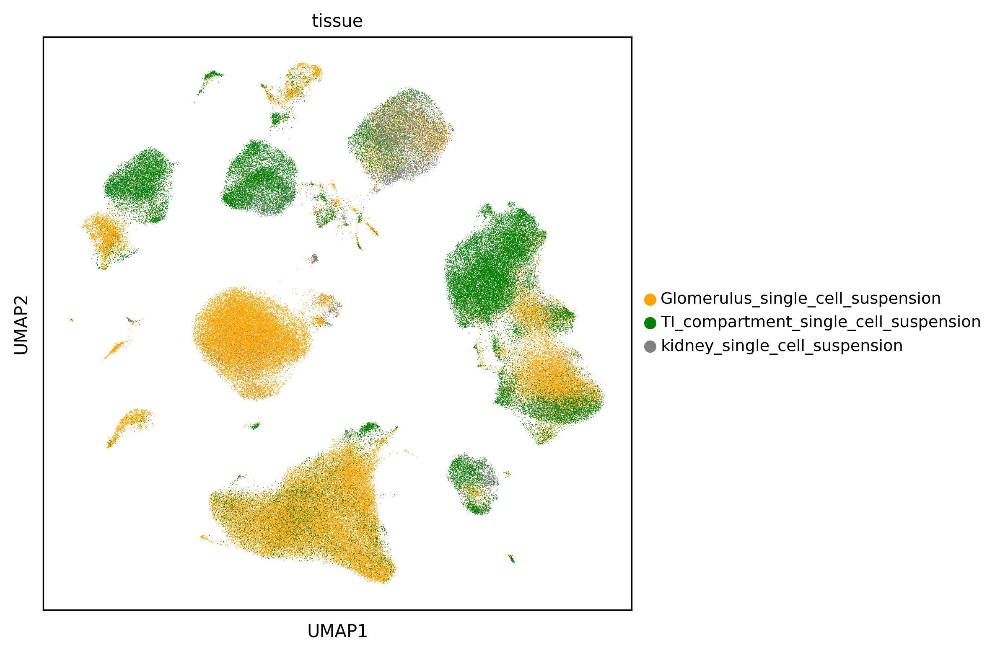

In [34]:
adata.uns['tissue_colors'] = ['orange', 'green', 'grey']
sc.pl.umap(adata, color = 'tissue')

In [35]:
#recompute umap
sc.pp.neighbors(adata, n_neighbors = 30, use_rep = 'X_scANVI')
sc.tl.umap(adata, min_dist= 0.4)

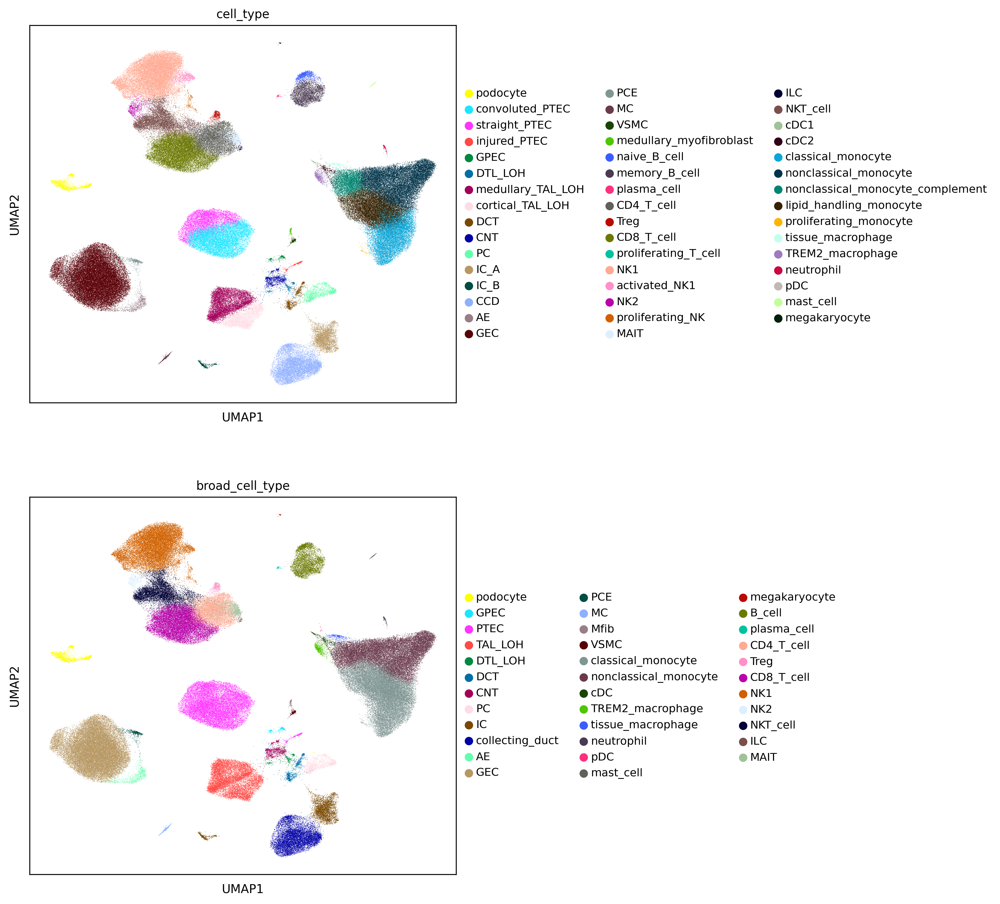

In [36]:
sc.pl.umap(adata, color = ['cell_type', 'broad_cell_type'], ncols =1)

In [37]:
#save this 
os.chdir('/lustre/scratch126/cellgen/team297/bs16/current_projects/kidney_glomTI_response')
adata.write_h5ad("./data/annotated/scRNAseq_glom_TI_kidney.h5ad")

In [38]:
immune = adata[adata.obs['compartment'].isin(['immune_myeloid', 'immune_lymphoid'])]

In [39]:
#recompute umap
sc.pp.neighbors(immune, n_neighbors = 30, use_rep = 'X_scANVI')
sc.tl.umap(immune, min_dist= 0.4)

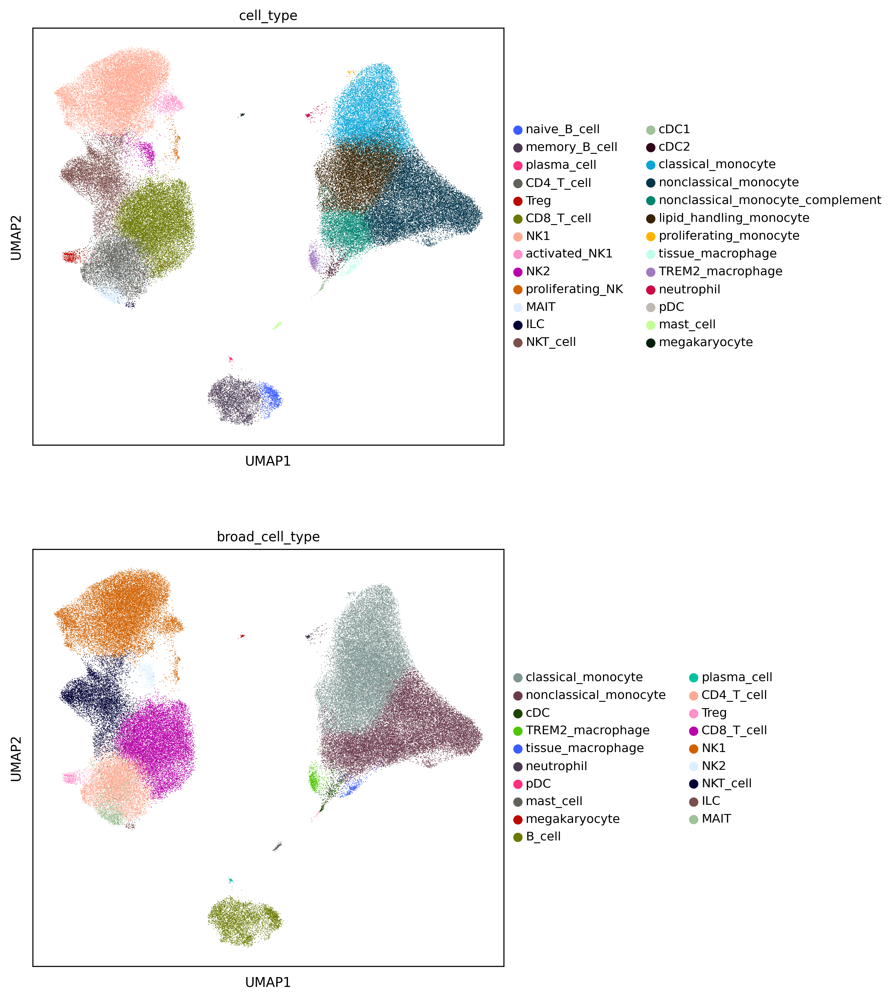

In [40]:
sc.pl.umap(immune, color = ['cell_type', 'broad_cell_type'], ncols =1)

In [41]:
#save this 
os.chdir('/lustre/scratch126/cellgen/team297/bs16/current_projects/kidney_glomTI_response')
immune.write_h5ad("./data/annotated/scRNAseq_glom_TI_kidney_immune_compartment.h5ad")